In [ ]:
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Limpieza de datos

In [ ]:
column_names = ['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology', 'Vertical_Distance_To_Hydrology', 
                'Horizontal_Distance_To_Roadways', 'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm', 
                'Horizontal_Distance_To_Fire_Points'] 
column_names += ['Wilderness_Area'+str(i+1) for i in range(4)]
column_names += ['Soil_Type'+str(i+1) for i in range(40)]
column_names += ['Cover_Type']

df = pd.read_csv('covtype.data', header=None, names=column_names)

df.head()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
0,2596,51,3,258,0,510,221,232,148,6279,...,0,0,0,0,0,0,0,0,0,5
1,2590,56,2,212,-6,390,220,235,151,6225,...,0,0,0,0,0,0,0,0,0,5
2,2804,139,9,268,65,3180,234,238,135,6121,...,0,0,0,0,0,0,0,0,0,2
3,2785,155,18,242,118,3090,238,238,122,6211,...,0,0,0,0,0,0,0,0,0,2
4,2595,45,2,153,-1,391,220,234,150,6172,...,0,0,0,0,0,0,0,0,0,5


In [ ]:
df.shape

(581012, 55)

In [ ]:
df.info()

In [ ]:
duplicates = df.duplicated()
if duplicates.any():
    print("True")
else:
    print("False")

False


In [ ]:
df.isna().sum()

In [ ]:
df.isnull().values.any()

False

In [ ]:
df2 = df.copy()

Vamos a dropear las 40 columnas de soil_type porque no son datos que nos interesen y tengan importancia

In [ ]:
columnas_soil_type = df2.filter(like='Soil_Type').columns
df2.drop(columnas_soil_type, axis=1, inplace=True)

In [ ]:
df2

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,Wilderness_Area1,Wilderness_Area2,Wilderness_Area3,Wilderness_Area4,Cover_Type
0,2596,51,3,258,0,510,221,232,148,6279,1,0,0,0,5
1,2590,56,2,212,-6,390,220,235,151,6225,1,0,0,0,5
2,2804,139,9,268,65,3180,234,238,135,6121,1,0,0,0,2
3,2785,155,18,242,118,3090,238,238,122,6211,1,0,0,0,2
4,2595,45,2,153,-1,391,220,234,150,6172,1,0,0,0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
581007,2396,153,20,85,17,108,240,237,118,837,0,0,1,0,3
581008,2391,152,19,67,12,95,240,237,119,845,0,0,1,0,3
581009,2386,159,17,60,7,90,236,241,130,854,0,0,1,0,3
581010,2384,170,15,60,5,90,230,245,143,864,0,0,1,0,3


# Ejercicio 1

Para conseguir un dataset con una dimensión reducidad, aplica la técnica de Selección de variables basada en árbol de decisión mediante las importancias de cada variable (Decision Trees Importances):

* Filtra el tablón para quedarnos solamente con las variables que aglutinan hasta el 95% de la información que se requiere para estimar la variable objetivo.
* random_state=100

In [ ]:
from sklearn.tree import DecisionTreeClassifier

Dividimos el dataset en características (X) y variable objetivo (y) que en este caso esta última es el cover_type:

In [ ]:
X = df2.drop("Cover_Type", axis=1)
y = df2["Cover_Type"]

Creamos un modelo de árbol de decision con DecisionTreeClassifier

In [ ]:
modelo_arbol = DecisionTreeClassifier(random_state=100)
modelo_arbol.fit(X, y)

DecisionTreeClassifier(random_state=100)

Ahora calculamos la importancia que tiene cada variable a la hora de determinar el tipo de cubierta

In [ ]:
importancias = modelo_arbol.feature_importances_

In [ ]:
importancias_acumuladas = pd.Series(importancias).sort_values(ascending=False).cumsum()

Nos quedamos con las columnas mas importantes

In [ ]:
caracteristicas_seleccionadas = importancias_acumuladas[importancias_acumuladas <= 0.95].index

In [ ]:
caracteristicas_seleccionadas 

Int64Index([0, 5, 9, 3, 4, 7, 6, 1, 8], dtype='int64')

In [ ]:
columnas_seleccionadas = X.columns[caracteristicas_seleccionadas].tolist()

In [ ]:
columnas_seleccionadas

['Elevation',
 'Horizontal_Distance_To_Roadways',
 'Horizontal_Distance_To_Fire_Points',
 'Horizontal_Distance_To_Hydrology',
 'Vertical_Distance_To_Hydrology',
 'Hillshade_Noon',
 'Hillshade_9am',
 'Aspect',
 'Hillshade_3pm']

In [ ]:
df_filtrado = X[columnas_seleccionadas]

df_filtrado es el dataset filtrado que contiene únicamente las variables que se consideran más relevantes para estimar el tipo de cubierta forestal (Cover_Type).

In [ ]:
df_filtrado

,Elevation,Horizontal_Distance_To_Roadways,Horizontal_Distance_To_Fire_Points,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Hillshade_Noon,Hillshade_9am,Aspect,Hillshade_3pm
0,2596,510,6279,258,0,232,221,51,148
1,2590,390,6225,212,-6,235,220,56,151
2,2804,3180,6121,268,65,238,234,139,135
3,2785,3090,6211,242,118,238,238,155,122
4,2595,391,6172,153,-1,234,220,45,150
...,...,...,...,...,...,...,...,...,...
581007,2396,108,837,85,17,237,240,153,118
581008,2391,95,845,67,12,237,240,152,119
581009,2386,90,854,60,7,241,236,159,130
581010,2384,90,864,60,5,245,230,170,143


# Ejercicio 2

Después de filtrar el dataset vamos a plantear un problema de clasificación para conseguir un clasificador de la cubierta forestal en basea a las variables cartográficas.:

**2.1** Genera una gráfica para visualizar la distribución de las variables del datset en conjunto. Analiza dicha gráfica y explica si hay una necesidad de normalizar los datos.


In [ ]:
import plotly.graph_objects as go

In [ ]:
fig = go.Figure()

fig.add_trace(go.Box(x=df_filtrado['Elevation'], name = 'Elevation', boxpoints='outliers',))
fig.add_trace(go.Box(x=df_filtrado['Horizontal_Distance_To_Roadways'], name = 'Horizontal_Distance_To_Roadways', boxpoints='outliers',))
fig.add_trace(go.Box(x=df_filtrado['Horizontal_Distance_To_Fire_Points'], name = 'Horizontal_Distance_To_Fire_Points', boxpoints='outliers',))
fig.add_trace(go.Box(x=df_filtrado['Horizontal_Distance_To_Hydrology'], name = 'Horizontal_Distance_To_Hydrology', boxpoints='outliers',))
fig.add_trace(go.Box(x=df_filtrado['Vertical_Distance_To_Hydrology'], name = 'Vertical_Distance_To_Hydrology', boxpoints='outliers',))
fig.add_trace(go.Box(x=df_filtrado['Hillshade_Noon'], name = 'Hillshade_Noon', boxpoints='outliers',))
fig.add_trace(go.Box(x=df_filtrado['Hillshade_9am'], name = 'Hillshade_9am', boxpoints='outliers',))
fig.add_trace(go.Box(x=df_filtrado['Aspect'], name = 'Aspect', boxpoints='outliers',))
fig.add_trace(go.Box(x=df_filtrado['Hillshade_3pm'], name = 'Hillshade_3pm', boxpoints='outliers',))

fig.update_layout(title_text="Diagrama de caja-bigotes")
fig.show()

Sí hace falta normalizar, porque como se ve en el gráfico hay muchos valores atípicos


**2.2** Normaliza todas las variables del dataset a una escala estándar. Para ello puedes realizar estas transformaciones:

* LLevar las variables de entrada a una escala de 0 a 1
* Convertir la variable objetivo en valores numéricos entre 0 y el número de clases menos 1

In [ ]:
from sklearn.preprocessing import MinMaxScaler, LabelEncoder

In [ ]:
scaler = MinMaxScaler()
df_norm = scaler.fit_transform(df_filtrado)

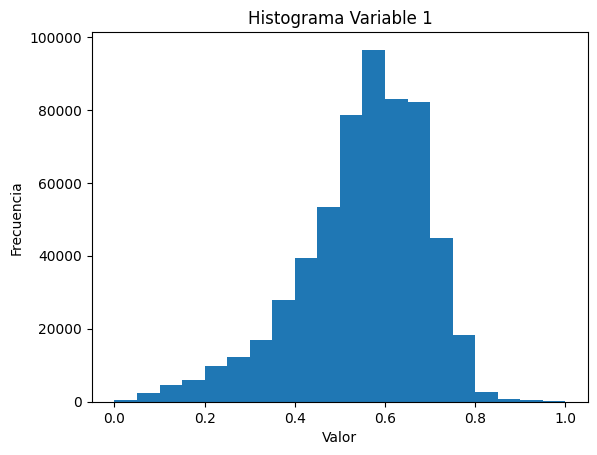

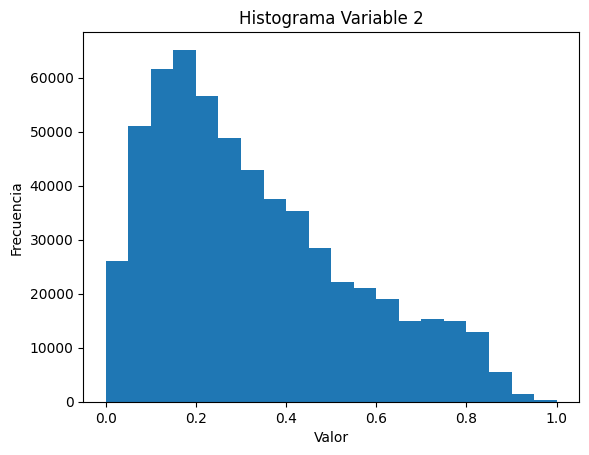

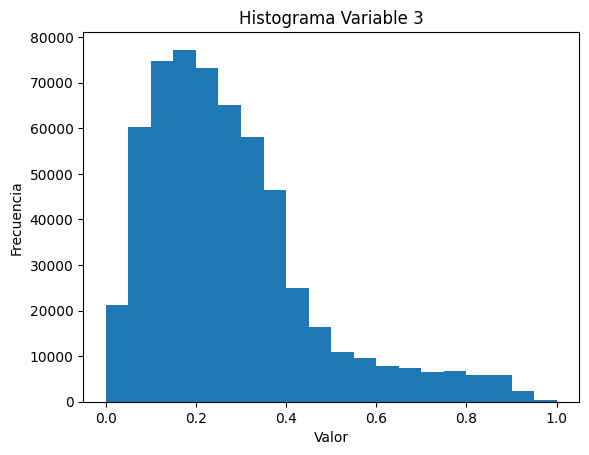

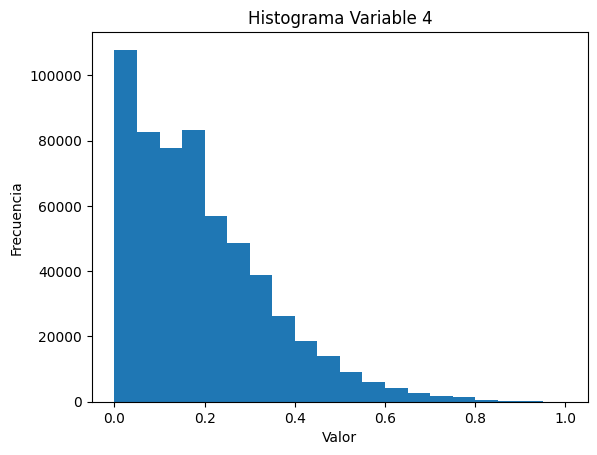

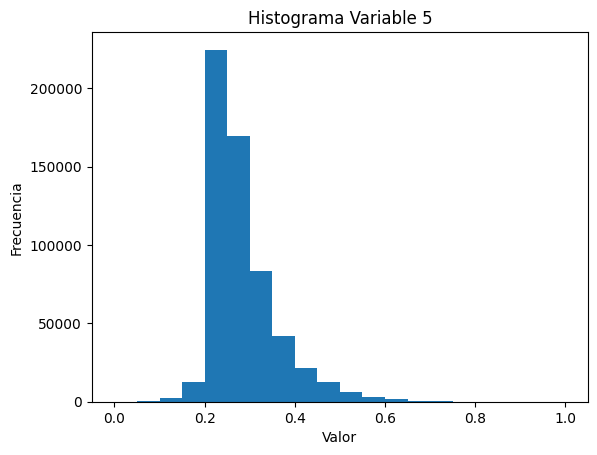

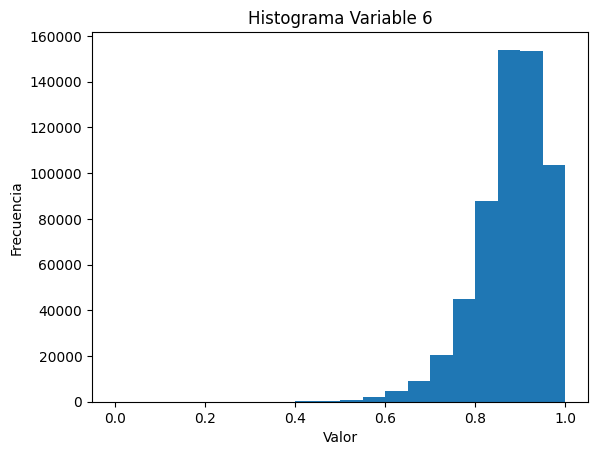

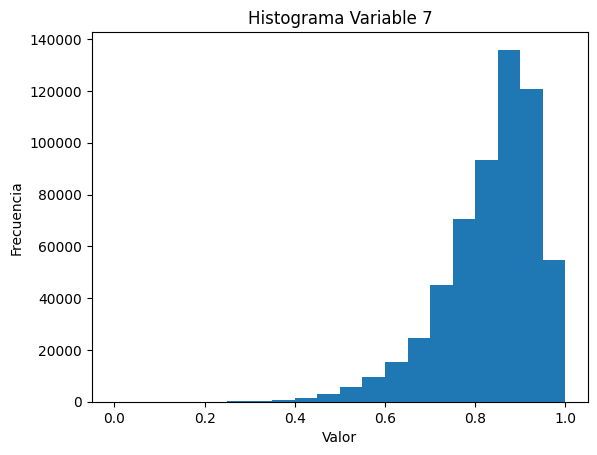

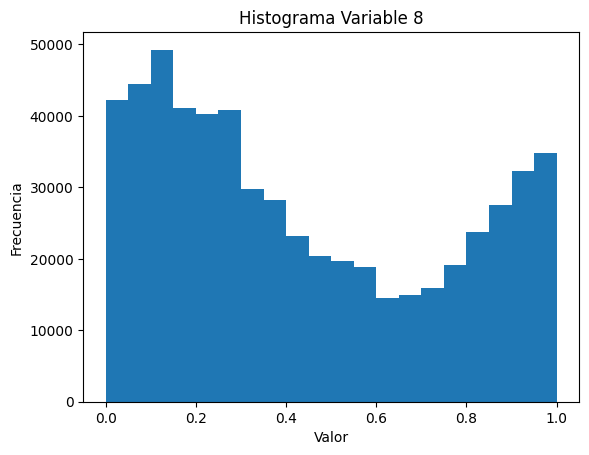

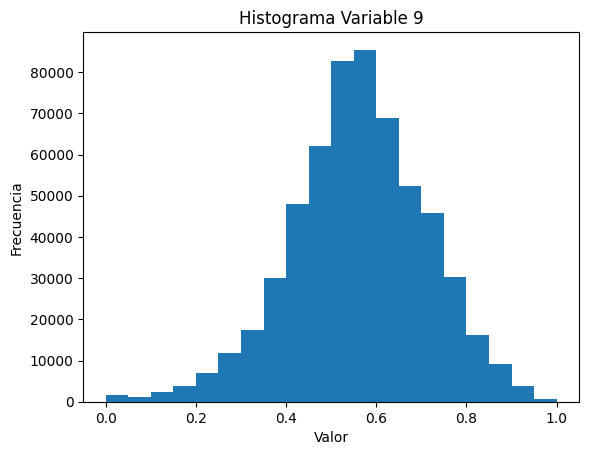

In [ ]:
for i in range(df_norm.shape[1]):
    plt.hist(df_norm[:, i], bins=20)
    plt.xlabel('Valor')
    plt.ylabel('Frecuencia')
    plt.title('Histograma Variable {}'.format(i+1))
    plt.show()

Los histrogramas nos sirven para comprobar que todas las variables se encuentran entre 0 y 1 y por lo tanto, están bien normalizados

# Ejercicio 3

Después de estandarizar los datos procedemos a crear el primer clasificador:

**3.1** Divide el datset en training y en test:

* Guarda el 20% de los datos para testeo.
* random_state=100

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df_norm, y, test_size=0.2, random_state=100)

El argumento test_size=0.2 indica que queremos reservar el 20% de los datos para el conjunto de prueba. El argumento random_state=100 asegura que la división se realice de manera reproducible

**3.2** Entrena un modelo de regresión logística:

* Número máximo de iteraciones igual a 1000
* random_state=100

In [ ]:
from sklearn.linear_model import LogisticRegression
model = LogisticRegression(max_iter=1000, random_state=100)
model.fit(X_train, y_train)

LogisticRegression(max_iter=1000, random_state=100)

 max_iter=1000 establece el número máximo de iteraciones del algoritmo de optimización utilizado por la regresión logística. El parámetro random_state=100. El parámetro random_state=100 se utiliza para asegurar la reproducibilidad de los resultados

**3.3** Calcula diferentes métricas para evaluar este modelo y analiza su rendimiendo.

* Accuracy
* F1-score (average='weighted')
* Classification report (zero_division=0)
* Confusion matrix

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
y_pred = model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
report = classification_report(y_test, y_pred, zero_division=0)
cm = confusion_matrix(y_test, y_pred)

print("Accuracy:", accuracy)
print("F1-Score:", f1)
print("Classification Report:\n", report)
print("Confusion Matrix:\n", cm)

Accuracy: 0.6942936068776193
F1-Score: 0.6772327246595772
Classification Report:
               precision    recall  f1-score   support

           1       0.67      0.70      0.69     42446
           2       0.73      0.79      0.76     56592
           3       0.62      0.71      0.66      7133
           4       0.60      0.09      0.16       571
           5       0.00      0.00      0.00      1847
           6       0.40      0.13      0.20      3456
           7       0.55      0.21      0.30      4158

    accuracy                           0.69    116203
   macro avg       0.51      0.37      0.39    116203
weighted avg       0.67      0.69      0.68    116203

Confusion Matrix:
 [[29739 12025     1     0     0     1   680]
 [11178 44527   732     0     0   143    12]
 [    0  1573  5050    32     0   478     0]
 [    0     4   469    52     0    46     0]
 [    4  1840     3     0     0     0     0]
 [    0  1111  1891     2     0   452     0]
 [ 3222    77     0     0     0 

In [62]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

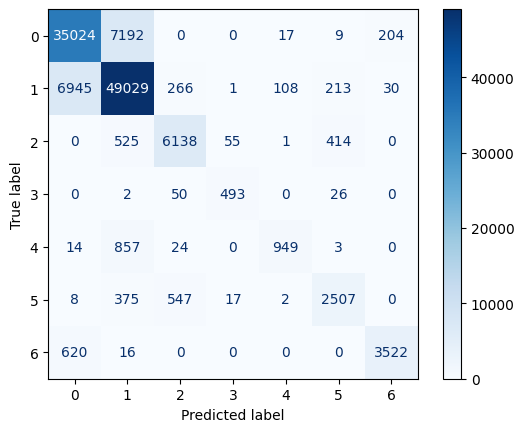

In [82]:
class_labels = ['0', '1', '2', '3', '4', '5', '6']

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(include_values=True, cmap='Blues', xticks_rotation='horizontal', ax=None)
plt.xticks()
plt.yticks()
plt.show()

# Ejercicio 4

Ahora probamos la creación de otros modelo basados en árboles de decisión:

**4.1** Entrena un modelo tipo Decision Tree Classifire y calcula las métricas correspondientes para analizar su rendimiento en comparación con el modelo anterior:

* random_state=100
* Accuracy
* F1-score (average='weighted')
* Classification report (zero_division=0)

In [ ]:
tree_classifier = DecisionTreeClassifier(random_state=100)
tree_classifier.fit(X_train, y_train)

DecisionTreeClassifier(random_state=100)

In [ ]:
y_pred_tree = tree_classifier.predict(X_test)

In [ ]:
accuracy = accuracy_score(y_test, y_pred_tree)
f1 = f1_score(y_test, y_pred_tree, average='weighted')
classification_report = classification_report(y_test, y_pred_tree, zero_division=0)

print("Accuracy:", accuracy)
print("F1-Score:", f1)
print("Classification Report:")
print(classification_report)

Accuracy: 0.9157250673390532
F1-Score: 0.9157096400978687
Classification Report:
              precision    recall  f1-score   support

           1       0.92      0.92      0.92     42446
           2       0.93      0.93      0.93     56592
           3       0.89      0.90      0.90      7133
           4       0.79      0.82      0.80       571
           5       0.77      0.78      0.77      1847
           6       0.84      0.82      0.83      3456
           7       0.91      0.92      0.92      4158

    accuracy                           0.92    116203
   macro avg       0.86      0.87      0.87    116203
weighted avg       0.92      0.92      0.92    116203



El modelo de árbol de decisión obtiene una mayor precisión (accuracy) y un F1-score más alto en comparación con el modelo de regresión logística, significa que tiene un mejor rendimiento en términos de clasificación.

**4.2** Saca la curva de complejidad del modelo Decision Tree (Model Complexity Curve) y crea un nuevo clasificador con el valor óptimo de la profundidad del árbol según esta gráfica. Después saca las métricas correspondiente y analiza el rendimiento del modelo en comparación de los anteriores.

* random_state=100
* rango de profundidades: de 2 a 30 inclusive

In [ ]:
from sklearn.model_selection import cross_val_score

La curva de complejidad permite determinar la capacidad que tiene de ajustarse los datos de entrenamiento y generalizar nuevos a un modelo de aprendizaje.

In [87]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import r2_score

In [88]:
hiper_param = np.arange(2,31)

train_r2 = np.zeros(hiper_param.size) 
test_r2 = np.zeros(hiper_param.size) 

for i in range(hiper_param.size):
    mod_arbol = DecisionTreeRegressor(max_depth=hiper_param[i], random_state=100)
    mod_arbol.fit(X_train, y_train)
    train_r2[i] = r2_score(y_train, mod_arbol.predict(X_train))
    test_r2[i] = r2_score(y_test, mod_arbol.predict(X_test))

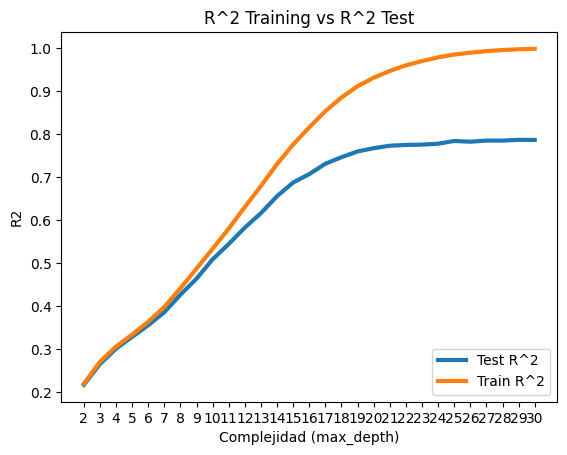

In [90]:
plt.plot(hiper_param, test_r2, linewidth=3, label='Test R^2')
plt.plot(hiper_param, train_r2, linewidth=3, label='Train R^2')
plt.xticks(hiper_param)
plt.title("R^2 Training vs R^2 Test")
plt.xlabel('Complejidad (max_depth)')
plt.ylabel('R2')
plt.legend(loc = 'lower right')

plt.show()

**4.3** Saca la gráfica de el Learning Curve para estos modelos, definiendo y aplicando una función que toma el valor del hiperparámetro como su entrada y dibuja la evolución del rendimiento del modelo para el conjunto de training y de test. Explica si este último modelo tiene preferencia o no, comparando con modelos anteriores.

* random_state=100
* (Sugerencia: No incluya más de 10 puntos en el eje horizontal y empieza la gráfica con un mínimo de 1000 muestras para el modelo)

In [91]:
from sklearn.model_selection import learning_curve

In [93]:
optimal_depth = hiper_param[np.argmax(test_r2)]

In [94]:
curve_tree= DecisionTreeClassifier(max_depth=optimal_depth, random_state=100)
curve_tree.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=29, random_state=100)

In [101]:
y_pred_curva = curve_tree.predict(X_test)

In [110]:
def learning_curve(max_depth: int):
    modelo_arbol = DecisionTreeRegressor(max_depth=max_depth, random_state=100)
    num_samples = np.linspace(start=1000, stop=X_train.shape[0], num=10, dtype=int)

    train_scores = np.zeros(num_samples.size) 
    test_scores = np.zeros(num_samples.size)

    for i, n in enumerate(num_samples):
        modelo_arbol.fit(X_train[:n], y_train[:n])
        train_scores[i] = r2_score(y_train[:n], modelo_arbol.predict(X_train[:n])) 
        test_scores[i] = r2_score(y_test, modelo_arbol.predict(X_test))

    plt.plot(num_samples, test_scores, label='Test R^2')
    plt.plot(num_samples, train_scores, label='Train R^2')
    plt.title('Curva de aprendizaje para max_depth = %s' % max_depth)
    plt.xlabel('Número de muestras de entrenamiento')
    plt.ylabel('R2')
    plt.legend(loc='best')
    plt.show()

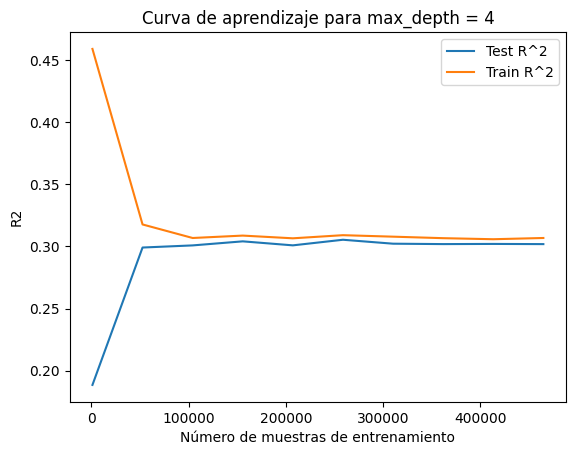

In [111]:
learning_curve(max_depth=4)

# Ejercicio 5

Ahora probamos la creación de otros modelo basados en bosques aleatorios:



**5.1** Entrena un modelo tipo Random Forest Classifire y calcula las métricas correspondientes para analizar su rendimiento en comparación con los modelos anteriores:

* random_state=100

In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
bosque = RandomForestClassifier(random_state=100)
bosque.fit(X_train, y_train)

y_pred = bosque.predict(X_test)

accuracy = accuracy_score(y_test, y_pred_curva)
f1 = f1_score(y_test, y_pred_curva, average='weighted')
classification_report_result = classification_report(y_test, y_pred_curva, zero_division=0)
print("Accuracy:", accuracy)
print("F1-Score:", f1)
print("Classification Report:")
print(classification_report_result)

**5.2** Consulta la profundidad de todos los árboles del bosque creado en el paso anterior y calcula la mediana de este parámetro.

In [ ]:
profundidades = [estimator.tree_.max_depth for estimator in bosque.estimators_]
median_depth = np.median(profundidades)

print("Mediana de la profundidad:", profundidades)

Mediana de la profundidad: 38.0


**5.3** Saca las curvas de complejidad del modelo Random Forest (Model Complexity Curve) y crea un nuevo clasificador con los valores óptimos analizados dentro de los rangos indicados para cada hiperparámeto. Después crea un modelo con estos parámetros "óptimos" y saca las métricas correspondientes para analizar el rendimiento del modelo en comparación con los anteriores.<br>

* random_state=100<br>
* define un rango con funciones de numpy para considerar estos números de árboles: [200, 250, 300, 350, 400] <br>
* rango de profundidades: de 20 a 40 inclusive en pasos de 2 en 2.
* considera estas opciones para max_features : ["auto", "log2", None]
* Accuracy<br>
* F1-score (average='weighted')<br>
* Classification report (zero_division=0)<br>
* OOB (out-of-bag score)<br>

In [ ]:
n_estimators_range = [200, 250, 300, 350, 400]
max_depth_range = range(20, 41, 2)
max_features_range = ["auto", "log2", None]

**5.4** Saca la gráfica del Learning Curve para estos modelos, definiendo y aplicando una función que toma el valor de los hiperparámetros analizados como su entrada y dibuja la evolución del rendimiento del modelo para el conjunto de training y de test. Explica si este último modelo tiene preferencia o no, comparando con modelos anteriores.

* random_state=100
* (Sugerencia: No incluya más de 10 puntos en el eje horizontal y empieza la gráfica con un mínimo de 1000 muestras para el modelo)

# Ejercicio 6

Ahora probamos la creación de otros modelo basados en Gradient Boosting:



**18.6.1** Entrena un modelo tipo XGBoost Classifire y calcula las métricas correspondientes para analizar su rendimiento en comparación con los modelos anteriores:
* random_state=100


In [ ]:
from xgboost import XGBClassifier

**6.2** Consulta el número y la profundidad máxima de los árboles del bosque 
creado en el paso anterior.



6.3 Saca las curvas de complejidad del modelo XGBClassifier (Model Complexity Curve) y crea un nuevo clasificador con los valores óptimos analizados dentro de los rangos indicados para cada hiperparámeto. Después crea un modelo con estos parámetros "óptimos" y saca las métricas correspondientes para analizar el rendimiento del modelo en comparación con los anteriores.

* random_state=100
* define un rango con funciones de numpy para considerar estos números de árboles: [100, 200, 300, 400, 500]
* rango de profundidades: de 6 a 20 inclusive en pasos de 2 en 2.
* valores a considerar para el learning_rate: [0.01, 0.1, 0.3, 0.5]
* Accuracy
* F1-score (average='weighted')
* Classification report (zero_division=0)

**6.4** Saca la gráfica del Learning Curve para estos modelos, definiendo y aplicando una función que toma el valor de los hiperparámetros analizados como su entrada y dibuja la evolución del rendimiento del modelo para el conjunto de training y de test. Explica si este último modelo tiene preferencia o no, comparando con modelos anteriores.

* random_state=100
* (Sugerencia: No incluya más de 10 puntos en el eje horizontal y empieza la gráfica con un mínimo de 1000 muestras para el modelo)

# Ejercicio 7

Ahora probamos la creación de otros modelos basados en métodos **Bayesianos**:

**7.1** Entrena un modelo para cada tipo de algoritmos Bayesianos y calcula las métricas correspondientes para analizar sus rendimientos en comparación con los modelos anteriores:

* GaussianNB
* MultinomialNB
* ComplementNB
* BernoulliNB
* Accuracy
* F1-score (average='weighted')
* Classification report (zero_division=0)

In [ ]:
from sklearn.naive_bayes import GaussianNB, MultinomialNB, ComplementNB, BernoulliNB

In [ ]:
gaussian_nb = GaussianNB()
gaussian_nb.fit(X_train, y_train)
gaussian_nb_pred = gaussian_nb.predict(X_test)

gaussian_nb_accuracy = accuracy_score(y_test, gaussian_nb_pred)
gaussian_nb_f1_score = f1_score(y_test, gaussian_nb_pred, average='weighted')
gaussian_nb_classification_report = classification_report(y_test, gaussian_nb_pred, zero_division=0)

In [ ]:
print("Accuracy:", gaussian_nb_accuracy)
print("F1-Score:", gaussian_nb_f1_score)
print("Classification Report:")
print(gaussian_nb_classification_report)

Accuracy: 0.6337185786941817
F1-Score: 0.6353069984351456
Classification Report:
              precision    recall  f1-score   support

           1       0.63      0.68      0.66     42446
           2       0.73      0.66      0.69     56592
           3       0.50      0.67      0.58      7133
           4       0.39      0.45      0.42       571
           5       0.20      0.22      0.21      1847
           6       0.32      0.30      0.31      3456
           7       0.28      0.27      0.28      4158

    accuracy                           0.63    116203
   macro avg       0.44      0.46      0.45    116203
weighted avg       0.64      0.63      0.64    116203



In [ ]:
multinomial_nb = MultinomialNB()
multinomial_nb.fit(X_train, y_train)
multinomial_nb_pred = multinomial_nb.predict(X_test)

multinomial_nb_accuracy = accuracy_score(y_test, multinomial_nb_pred)
multinomial_nb_f1_score = f1_score(y_test, multinomial_nb_pred, average='weighted')
multinomial_nb_classification_report = classification_report(y_test, multinomial_nb_pred, zero_division=0)

In [ ]:
print("Accuracy:", multinomial_nb_accuracy)
print("F1-Score:", multinomial_nb_f1_score)
print("Classification Report:")
print(multinomial_nb_classification_report)

Accuracy: 0.48700980181234566
F1-Score: 0.31900065052998366
Classification Report:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00     42446
           2       0.49      1.00      0.66     56592
           3       0.00      0.00      0.00      7133
           4       0.00      0.00      0.00       571
           5       0.00      0.00      0.00      1847
           6       0.00      0.00      0.00      3456
           7       0.00      0.00      0.00      4158

    accuracy                           0.49    116203
   macro avg       0.07      0.14      0.09    116203
weighted avg       0.24      0.49      0.32    116203



In [ ]:
complement_nb = ComplementNB()
complement_nb.fit(X_train, y_train)
complement_nb_pred = complement_nb.predict(X_test)

complement_nb_accuracy = accuracy_score(y_test, complement_nb_pred)
complement_nb_f1_score = f1_score(y_test, complement_nb_pred, average='weighted')
complement_nb_classification_report = classification_report(y_test, complement_nb_pred, zero_division=0)

In [ ]:
print("Accuracy:", complement_nb_accuracy)
print("F1-Score:", complement_nb_f1_score)
print("Classification Report:")
print(complement_nb_classification_report)

Accuracy: 0.42533325301412184
F1-Score: 0.44553100544707647
Classification Report:
              precision    recall  f1-score   support

           1       0.57      0.50      0.53     42446
           2       0.66      0.38      0.48     56592
           3       0.15      0.92      0.25      7133
           4       0.00      0.00      0.00       571
           5       0.02      0.00      0.00      1847
           6       0.00      0.00      0.00      3456
           7       0.07      0.02      0.03      4158

    accuracy                           0.43    116203
   macro avg       0.21      0.26      0.19    116203
weighted avg       0.54      0.43      0.45    116203



In [ ]:
bernoulli_nb = BernoulliNB()
bernoulli_nb.fit(X_train, y_train)
bernoulli_nb_pred = bernoulli_nb.predict(X_test)

bernoulli_nb_accuracy = accuracy_score(y_test, bernoulli_nb_pred)
bernoulli_nb_f1_score = f1_score(y_test, bernoulli_nb_pred, average='weighted')
bernoulli_nb_classification_report = classification_report(y_test, bernoulli_nb_pred, zero_division=0)

In [ ]:
print("Accuracy:", bernoulli_nb_accuracy)
print("F1-Score:", bernoulli_nb_f1_score)
print("Classification Report:")
print(bernoulli_nb_classification_report)

Accuracy: 0.49091675774291543
F1-Score: 0.35745601519389814
Classification Report:
              precision    recall  f1-score   support

           1       0.44      0.06      0.11     42446
           2       0.49      0.96      0.65     56592
           3       0.26      0.00      0.00      7133
           4       0.00      0.00      0.00       571
           5       0.00      0.00      0.00      1847
           6       0.00      0.00      0.00      3456
           7       0.00      0.00      0.00      4158

    accuracy                           0.49    116203
   macro avg       0.17      0.15      0.11    116203
weighted avg       0.42      0.49      0.36    116203



**7.2** Saca la gráfica del Learning Curve para el modelo GaussianNB y explica si este modelo sufre de un posible "Overfitting" o "Underfitting" comparando con modelos anteriores.

* random_state=100
* (Sugerencia: No incluya más de 10 puntos en el eje horizontal y empieza la gráfica con un mínimo de 1000 muestras para el modelo)

In [ ]:
from sklearn.model_selection import learning_curve

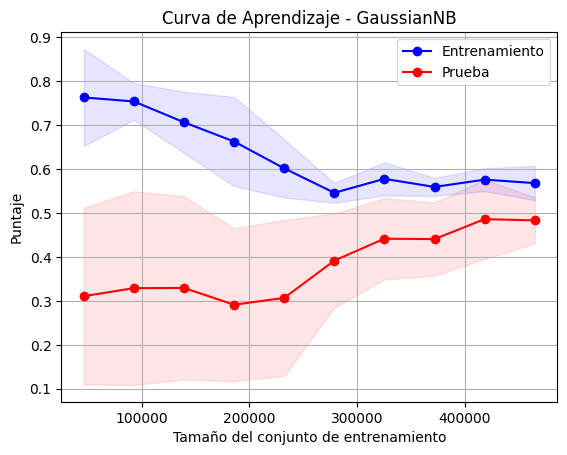

In [ ]:
gaussian_nb = GaussianNB()

train_sizes, train_scores, test_scores = learning_curve(gaussian_nb, X, y, cv=5, random_state=100,train_sizes=np.linspace(0.1, 1.0, 10))

train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

plt.figure()
plt.title('Curva de Aprendizaje - GaussianNB')
plt.xlabel('Tamaño del conjunto de entrenamiento')
plt.ylabel('Puntaje')
plt.grid()

plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.1, color='b')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.1, color='r')
plt.plot(train_sizes, train_scores_mean, 'o-', color='b', label='Entrenamiento')
plt.plot(train_sizes, test_scores_mean, 'o-', color='r', label='Prueba')

plt.legend(loc='best')
plt.show()

# Ejercicio 8

Ahora probamos la creación de otros modelo basados en K vecinos más cercanos:



**8.1** Entrena un modelo tipo K-Nearest Neighbors con la configuración por defecto y otros dos modelos con 1 y 100 vecinos más cercanos. Calcula las métricas correspondientes para analizar sus rendimientos en comparación con el modelo anteriores:

* random_state=100
* Accuracy
* F1-score (average='weighted')
* Classification report (zero_division=0)

Por defecto

In [121]:
from sklearn.neighbors import KNeighborsClassifier

knn_default = KNeighborsClassifier()
knn_default.fit(X_train, y_train)
knn_default_pred = knn_default.predict(X_test)

In [127]:
default_accuracy = accuracy_score(y_test, knn_default_pred)
default_f1_score = f1_score(y_test, knn_default_pred, average='weighted')
#default_classification_report = classification_report(y_test, knn_default_pred, zero_division=0)

In [128]:
print("Modelo con configuración por defecto:")
print("Accuracy:", default_accuracy)
print("F1-Score:", default_f1_score)
print("Classification Report:")
#print(default_classification_report)
print()

Modelo con configuración por defecto:
Accuracy: 0.925174048862766
F1-Score: 0.9249437292234242
Classification Report:



Para 1 vecino

In [122]:
knn_1_neighbor = KNeighborsClassifier(n_neighbors=1)
knn_1_neighbor.fit(X_train, y_train)
knn_1_neighbor_pred = knn_1_neighbor.predict(X_test)

**8.2** Saca la gráfica del Learning Curve para estos modelos, definiendo y aplicando una función que toma el valor del hiperparámetro analizado como su entrada y dibuja la evolución del rendimiento del modelo para el conjunto de training y de test. Explica si este último modelo tiene preferencia o no, comparando con modelos anteriores.

* (Sugerencia: No incluya más de 5 puntos en el eje horizontal y empieza la gráfica con un mínimo de 1000 muestras para el modelo)

# Ejercicio 9 

Ahora probamos la creación de otros modelo basados en Redes Neuronales:



**9.1** Entrena un modelo tipo MLPClassifier y calcula las métricas correspondientes para analizar su rendimiento en comparación con los modelos anteriores:

* random_state=100

**9.2** Entrena otro modelo tipo MLPClassifier indicando los siguientes hiperparámetros y calcula las métricas correspondientes para analizar su rendimiento en comparación con los modelos anteriores:

* random_state=100
* hidden_layer_sizes=(100,200,100)
* Número máximo de iteraciones igual a 10000
* alpha=1e-5
* tol=1e-5